<a href="https://colab.research.google.com/github/ramakrishnan-thiyagu/TVS-interview-task/blob/main/TVS_interview.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [23]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

In [24]:
data=pd.read_excel('/content/drive/MyDrive/Trip Data..xlsx', sheet_name='VTS Data 280820')
data.shape

(6880, 32)

In [25]:
pd.set_option('max_columns', 32)
data.head()

,GpsProvider,BookingID,Market/Regular,BookingID_Date,vehicle_no,Origin_Location,Destination_Location,Org_lat_lon,Des_lat_lon,Data_Ping_time,Planned_ETA,Current_Location,DestinationLocation,actual_eta,Curr_lat,Curr_lon,ontime,delay,OriginLocation_Code,DestinationLocation_Code,trip_start_date,trip_end_date,TRANSPORTATION_DISTANCE_IN_KM,vehicleType,Minimum_kms_to_be_covered_in_a_day,Driver_Name,Driver_MobileNo,customerID,customerNameCode,supplierID,supplierNameCode,Material Shipped
0,CONSENT TRACK,MVCV0000927/082021,Market,2020-08-17 14:59:01.000,KA590408,"TVSLSL-PUZHAL-HUB,CHENNAI,TAMIL NADU","ASHOK LEYLAND PLANT 1- HOSUR,HOSUR,KARNATAKA","13.1550,80.1960","12.7400,77.8200",2020-08-24 00:05:09,2020-08-21 18:59:01.000,"Vaniyambadi Rd, Valayambattu, Tamil Nadu 63575...","ASHOK LEYLAND PLANT 1- HOSUR,HOSUR,KARNATAKA",2020-08-28 14:38:04.447,12.663500,78.649870,NaN,R,CHEPUZTVSHUA1,HOSHOSALLCCA2,2020-08-17 14:59:01,NaT,320.0,NaN,NaN,NaN,NaN,ALLEXCHE45,Ashok leyland limited,VIJEXHOSR7,VIJAY TRANSPORT,BRACKET / GRAB HANDLE
1,VAMOSYS,VCV00014271/082021,Regular,2020-08-27 16:22:22.827,TN30BC5917,"DAIMLER INDIA COMMERCIAL VEHICLES,KANCHIPURAM,...","DAIMLER INDIA COMMERCIAL VEHICLES,KANCHIPURAM,...","12.8390,79.9540","12.8390,79.9540",2020-08-28 12:40:28,2020-08-31 20:22:22.827,"Unnamed Road, Oragadam Industrial Corridor, Va...","DAIMLER INDIA COMMERCIAL VEHICLES,KANCHIPURAM,...",2020-08-28 12:46:17.007,12.836757,79.954428,G,NaN,CHEORADMRCCB1,CHEMATDMROPA7,2020-08-27 16:21:52,NaT,103.0,NaN,NaN,RAMESH,NaN,DMREXCHEUX,Daimler india commercial vehicles pvt lt,VJLEXSHE09,VJ LOGISTICS,ZB MODEL PLATE / 3143
2,CONSENT TRACK,VCV00014382/082021,Regular,2020-08-27 17:59:24.987,TN22AR2748,"LUCAS TVS LTD-PONDY,PONDY,PONDICHERRY","LUCAS TVS LTD-PONDY,PONDY,PONDICHERRY","11.8710,79.7390","11.8710,79.7390",2020-08-28 09:05:09,2020-08-31 21:59:24.987,"570, National Hwy 48, Shenoy Nagar, Chennai, T...","LUCAS TVS LTD-PONDY,PONDY,PONDICHERRY",2020-08-28 16:03:30.793,13.073956,80.225780,G,NaN,CHEPONLUTCCA4,CHEPONLUTCCA4,2020-08-27 17:57:04,NaT,300.0,NaN,NaN,GIRI,NaN,LUTGCCHE06,Lucas tvs ltd,GSTEXLAK1Q,G.S. TRANSPORT,LETTERING / FUSO
3,VAMOSYS,VCV00014743/082021,Regular,2020-08-28 00:48:24.503,TN28AQ0781,"DAIMLER INDIA COMMERCIAL VEHICLES,KANCHIPURAM,...","DAIMLER INDIA COMMERCIAL VEHICLES,KANCHIPURAM,...","12.8390,79.9540","12.8390,79.9540",2020-08-28 12:40:31,2020-09-01 04:48:24.503,"Singaperumal Koil - Sriperumbudur Rd, Oragadam...","DAIMLER INDIA COMMERCIAL VEHICLES,KANCHIPURAM,...",2020-08-28 12:50:27.997,12.836686,79.950560,G,NaN,CHEORADMRCCB1,CHEMATDMROPA7,2020-08-28 00:47:45,NaT,61.0,NaN,NaN,RAVI,NaN,DMREXCHEUX,Daimler india commercial vehicles pvt lt,ARVEXNAM09,ARVINTH TRANSPORT,LU STRUT RA / RADIUS ROD
4,VAMOSYS,VCV00014744/082021,Regular,2020-08-28 01:23:19.243,TN68F1722,"LUCAS TVS LTD-PONDY,PONDY,PONDICHERRY","LUCAS TVS LTD-PONDY,PONDY,PONDICHERRY","11.8720,79.6320","11.8720,79.6320",2020-08-28 12:40:29,2020-09-01 05:23:19.243,"Melmaruvathur, Tamil Nadu 603319, India","LUCAS TVS LTD-PONDY,PONDY,PONDICHERRY",2020-08-28 14:22:50.127,12.429501,79.831556,G,NaN,CHENETLUTCCA1,CHENETLUTCCA1,2020-08-28 01:13:48,NaT,240.0,NaN,NaN,TAMIL,NaN,LUTGCCHE06,Lucas tvs ltd,SRTEXKOR96,SR TRANSPORTS,WISHBONE / V ROD/HDT


In [26]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6880 entries, 0 to 6879
Data columns (total 32 columns):
 #   Column                              Non-Null Count  Dtype         
---  ------                              --------------  -----         
 0   GpsProvider                         5927 non-null   object        
 1   BookingID                           6880 non-null   object        
 2   Market/Regular                      6880 non-null   object        
 3   BookingID_Date                      6880 non-null   datetime64[ns]
 4   vehicle_no                          6880 non-null   object        
 5   Origin_Location                     6880 non-null   object        
 6   Destination_Location                6880 non-null   object        
 7   Org_lat_lon                         6880 non-null   object        
 8   Des_lat_lon                         6880 non-null   object        
 9   Data_Ping_time                      5927 non-null   datetime64[ns]
 10  Planned_ETA             

In [27]:
#making a copy of data before preprocessing
data_raw=data.copy()

In [28]:
import pandas_profiling

In [29]:
pandas_profiling.ProfileReport(data)

Summarize dataset:   0%|          | 0/44 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [30]:
#let's create a ontime column from ontime and delay columns
data['ontime']=data.ontime.replace({np.NaN, 'G'}, {0, 1})

In [ ]:
#let's drop features which are not going to help in the problem domain
#Destination location have a duplicate. So we can drop one
#we have origin and destination names do let's drop origin and destination id
#we have customer name and supplier name so let's drop it's ids

data.drop(['BookingID', 'DestinationLocation', 'OriginLocation_Code',
           'DestinationLocation_Code', 'Driver_MobileNo', 'customerID',
           'supplierID', 'delay'], axis=1, inplace=True)

In [31]:
data.columns

Index(['GpsProvider', 'BookingID', 'Market/Regular ', 'BookingID_Date',
       'vehicle_no', 'Origin_Location', 'Destination_Location', 'Org_lat_lon',
       'Des_lat_lon', 'Data_Ping_time', 'Planned_ETA', 'Current_Location',
       'DestinationLocation', 'actual_eta', 'Curr_lat', 'Curr_lon', 'ontime',
       'delay', 'OriginLocation_Code', 'DestinationLocation_Code',
       'trip_start_date', 'trip_end_date', 'TRANSPORTATION_DISTANCE_IN_KM',
       'vehicleType', 'Minimum_kms_to_be_covered_in_a_day', 'Driver_Name',
       'Driver_MobileNo', 'customerID', 'customerNameCode', 'supplierID',
       'supplierNameCode', 'Material Shipped'],
      dtype='object')

In [ ]:
df1=data[[ 'Market/Regular ', 'BookingID_Date',
       'vehicle_no', 'Origin_Location', 'Destination_Location', 'Org_lat_lon',
       'Des_lat_lon', 'Data_Ping_time', 'Planned_ETA', 'Current_Location',
       'DestinationLocation', 'actual_eta', 'Curr_lat', 'Curr_lon', 'ontime',
       'delay', 'OriginLocation_Code', 'DestinationLocation_Code',
       'trip_start_date', 'trip_end_date', 'TRANSPORTATION_DISTANCE_IN_KM',
       'vehicleType', 'Minimum_kms_to_be_covered_in_a_day', 'Driver_Name',
       'Driver_MobileNo', 'customerID', 'customerNameCode', 'supplierID',
       'supplierNameCode', 'Material Shipped']]

In [10]:
data.sort_values('trip_start_date').head(5)

,GpsProvider,Market/Regular,BookingID_Date,vehicle_no,Origin_Location,Destination_Location,Org_lat_lon,Des_lat_lon,Data_Ping_time,Planned_ETA,Current_Location,actual_eta,Curr_lat,Curr_lon,ontime,trip_start_date,trip_end_date,TRANSPORTATION_DISTANCE_IN_KM,vehicleType,Minimum_kms_to_be_covered_in_a_day,Driver_Name,customerNameCode,supplierNameCode,Material Shipped
6868,JTECH,Regular,2019-04-15 15:15:13,KA21A5090,"Mugabala, Bangalore Rural, Karnataka","Peenya Small Industries, Bangalore, Karnataka","16.560192249175344,80.792293091599547","13.196312912801169,77.708156925688726",2019-06-14 15:20:12,1899-12-30 04:06:00,"Shed No 60, Medahalli Kadugodi Road, Virgonaga...",1899-12-30 03:21:00,13.025077,77.723114,0,1899-12-30 00:00:00,1899-12-30 03:21:00,41.0,40 FT 3XL Trailer 35MT,NaN,NaN,Larsen & toubro limited,A S TRANSPORTS,INSRT-VLV ST INTK
6264,NaN,Regular,2019-06-10 13:17:44,WB59B9152,"Sonai, Kolkata, West Bengal","Kalyani, Nadia, West Bengal","23.525267916088961,87.264424348570884","22.952176370977448,88.4571405591546",NaT,1899-12-30 08:58:00,NaN,1899-12-30 08:13:00,NaN,NaN,1,1899-12-30 00:00:00,1899-12-30 08:13:00,51.0,40 FT Flat Bed Multi-Axle 27MT - Trailer,NaN,NaN,Larsen & toubro limited,SUNITA CARRIERS PRIVATE LIMITED,FXUWB-LID COVER
5910,NaN,Regular,2019-03-18 12:19:22,AP26TE1258,"Sedarapet, India","Redhills, Chennai, Tamil Nadu, India","12.0001,79.74839949999999","13.1992334,80.196693",NaT,2019-03-19 11:45:22,NaN,2019-03-19 11:00:22,NaN,NaN,1,2019-03-18 12:19:22,2019-03-19 11:00:22,NaN,24 | 26 FT Taurus Open 21MT - HCV,NaN,NaN,Larsen & toubro limited,Sri Ayyappan Agencies,COOLANT HOSE / RADIATOR TO ENGINE
6631,NaN,Regular,2019-03-18 16:24:18,TN20AJ1188,"Kanchipuram, Tamil Nadu, India","Periyapatti, Tamil Nadu, India","12.8341735,79.7036402","11.2044996,78.1421905",NaT,2019-03-20 18:00:18,NaN,2019-03-20 17:15:18,NaN,NaN,1,2019-03-18 16:24:18,2019-03-20 17:15:18,NaN,22 FT Taurus Open 16MT - HCV,275.0,NaN,Larsen & toubro limited,Unknown,A114 Alternator(New Versa)
5912,NaN,Regular,2019-03-18 16:56:02,TN25AT7677,"Sedarapet, India","Mylasandra, Bengaluru, Karnataka, India","12.0001,79.74839949999999","12.853929,77.6178125",NaT,2019-03-20 12:38:02,NaN,2019-03-20 11:53:02,NaN,NaN,1,2019-03-18 16:56:02,2019-03-20 11:53:02,NaN,24 | 26 FT Taurus Open 21MT - HCV,NaN,NaN,Larsen & toubro limited,Unknown,COOLANT HOSE


In [11]:
#As we have mistake in those 2 rows let's remove those
data.drop(data.index[[6868,6264]], inplace=True)

Missing value Inputation

In [12]:
#drivers may have particular kms as target in certain days, so imputing null with 0's
data['Minimum_kms_to_be_covered_in_a_day']=data['Minimum_kms_to_be_covered_in_a_day'].fillna(0)

#let's name unkown for null values in driver name
data['Driver_Name']=data['Driver_Name'].fillna('Unknown')

#let's impute vehicle type with mode value
data['vehicleType']=data['vehicleType'].fillna(data['vehicleType'].mode()[0])

#let's impute transportation distence with mean value
data['TRANSPORTATION_DISTANCE_IN_KM']=data['TRANSPORTATION_DISTANCE_IN_KM'].fillna(data['TRANSPORTATION_DISTANCE_IN_KM'].mean())

In [13]:
data.isna().sum()

GpsProvider                           952
Market/Regular                          0
BookingID_Date                          0
vehicle_no                              0
Origin_Location                         0
Destination_Location                    0
Org_lat_lon                             0
Des_lat_lon                             0
Data_Ping_time                        952
Planned_ETA                             0
Current_Location                      963
actual_eta                             37
Curr_lat                              952
Curr_lon                              952
ontime                                  0
trip_start_date                         0
trip_end_date                         194
TRANSPORTATION_DISTANCE_IN_KM           0
vehicleType                             0
Minimum_kms_to_be_covered_in_a_day      0
Driver_Name                             0
customerNameCode                        0
supplierNameCode                        0
Material Shipped                  

In [14]:
data.dropna(subset=['Current_Location', 'trip_end_date', 'actual_eta'], inplace=True)

In [15]:
data.isna().sum()

GpsProvider                           0
Market/Regular                        0
BookingID_Date                        0
vehicle_no                            0
Origin_Location                       0
Destination_Location                  0
Org_lat_lon                           0
Des_lat_lon                           0
Data_Ping_time                        0
Planned_ETA                           0
Current_Location                      0
actual_eta                            0
Curr_lat                              0
Curr_lon                              0
ontime                                0
trip_start_date                       0
trip_end_date                         0
TRANSPORTATION_DISTANCE_IN_KM         0
vehicleType                           0
Minimum_kms_to_be_covered_in_a_day    0
Driver_Name                           0
customerNameCode                      0
supplierNameCode                      0
Material Shipped                      0
dtype: int64

Outlier Treatment

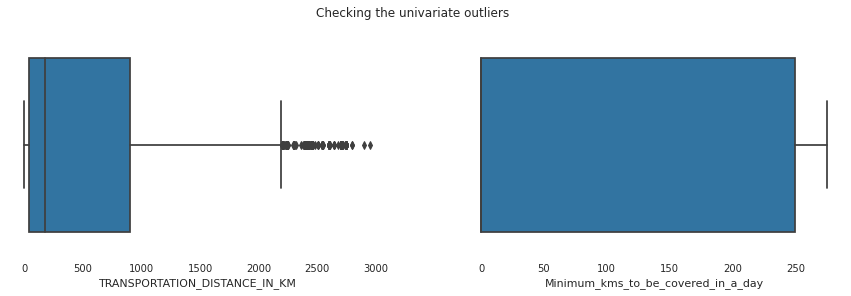

In [20]:
plt.rcParams['figure.figsize']=15,4
plt.subplot(121)
sns.boxplot(data['TRANSPORTATION_DISTANCE_IN_KM'])

plt.subplot(122)
sns.boxplot(data['Minimum_kms_to_be_covered_in_a_day'])

plt.suptitle('Checking the univariate outliers')
plt.show()

In [21]:
#let's cap the higher values outliers to reasonable values
data['TRANSPORTATION_DISTANCE_IN_KM'].values[data['TRANSPORTATION_DISTANCE_IN_KM'].values>2750]=2750

In [132]:
data_1st[data_1st['Current_Location'].isna()]

,GpsProvider,Market/Regular,BookingID_Date,vehicle_no,Origin_Location,Destination_Location,Org_lat_lon,Des_lat_lon,Data_Ping_time,Planned_ETA,Current_Location,actual_eta,Curr_lat,Curr_lon,ontime,trip_start_date,trip_end_date,TRANSPORTATION_DISTANCE_IN_KM,vehicleType,Minimum_kms_to_be_covered_in_a_day,Driver_Name,customerNameCode,supplierNameCode,Material Shipped
1514,VINAYAKA_TVS,Regular,2020-08-07 11:27:20,KA52A5807,"Onnalvadi, Krishnagiri, Tamil Nadu","Shive, Pune, Maharashtra","12.683589,77.859239","18.750621,73.87719",2020-08-11 14:45:25,2020-08-08 03:32:00,NaN,NaT,18.699200,73.695900,0,2020-08-07 11:27:20,2020-08-11 14:35:00,935.0,32 FT Single-Axle 7MT - HCV,0.0,VASU T N,Neel metal products ltd,SRI VINAYAKA TRANSPORT,AUTO PARTS
1522,VAMOSYS,Regular,2020-08-08 12:06:24,TN88C3198,"Jagadambigainagar, Tiruvallur, Tamil Nadu","Shive, Pune, Maharashtra","13.087428,80.184717","18.750621,73.87719",2020-08-11 14:00:30,2020-08-12 16:06:24,NaN,NaT,18.698302,73.840493,1,2020-08-08 12:06:24,2020-08-11 13:51:00,1199.0,32 FT Multi-Axle 14MT - HCV,0.0,PANANISAMY S,Lucas tvs ltd,Arvinth Transport,AUTO PARTS
1566,Garuda,Regular,2020-08-04 13:16:33,TN54K7999,"Khorajnanoda, Ahmedabad, Gujarat","Singaperumalkoil, Kanchipuram, Tamil Nadu","22.961777,72.094219","12.786517,79.975221",2020-08-10 23:15:26,2020-08-08 17:16:33,NaN,NaT,12.785138,80.014267,0,2020-08-04 13:16:33,2020-08-10 23:18:00,1900.0,32 FT Multi-Axle 14MT - HCV,0.0,JOTHIRAMALINGAM.K,Ford india private limited,FRIENDS TRANSPORT,AUTO PARTS
1572,KRC LOGISTICS,Regular,2020-08-04 16:19:51,TN14T6171,"Jagadambigainagar, Tiruvallur, Tamil Nadu","Shive, Pune, Maharashtra","13.087428,80.184717","18.750621,73.87719",2020-08-10 17:45:19,2020-08-08 20:19:51,NaN,NaT,12.767053,80.005253,0,2020-08-04 16:19:51,2020-08-10 17:43:00,1199.0,32 FT Multi-Axle 14MT - HCV,0.0,MAHESHKUMAR N,Brakes india private ltd,KRC Logistics,AUTO PARTS
1575,KRC LOGISTICS,Regular,2020-08-07 10:49:33,TN14T6099,"Shive, Pune, Maharashtra","Pondur, Kanchipuram, Tamil Nadu","18.750621,73.87719","12.930429,79.931163",2020-08-10 16:55:21,2020-08-11 14:49:33,NaN,NaT,12.836378,79.951233,1,2020-08-07 10:49:33,2020-08-10 16:49:00,1290.0,32 FT Multi-Axle 14MT - HCV,0.0,DILLIBABU A,Daimler india commercial vehicles pvt lt,KRC Logistics,BEARING BUSH
1587,KRC LOGISTICS,Regular,2020-08-04 16:31:33,TN14T4848,"Perukkaranai, Kanchipuram, Tamil Nadu","Shive, Pune, Maharashtra","12.425747,79.880083","18.750621,73.87719",2020-08-10 12:40:20,2020-08-08 20:31:33,NaN,NaT,12.836737,79.950260,0,2020-08-04 16:31:33,2020-08-10 12:36:00,1199.0,32 FT Multi-Axle 14MT - HCV,0.0,ARVINDHA KUMAR S,Brakes india private ltd,KRC Logistics,EMPTY TRAYS
1592,KRC LOGISTICS,Regular,2020-08-07 09:53:49,TN14T6162,"Jagadambigainagar, Tiruvallur, Tamil Nadu","Shive, Pune, Maharashtra","13.087428,80.184717","18.750621,73.87719",2020-08-10 11:15:15,2020-08-11 13:53:49,NaN,NaT,18.743571,73.811982,1,2020-08-07 09:53:49,2020-08-10 11:04:00,1199.0,32 FT Multi-Axle 14MT - HCV,0.0,JOHN SENTHIL V,Lucas tvs ltd,KRC Logistics,AUTO PARTS
1594,TransCargo,Regular,2020-08-03 12:15:13,HR38W1423,"Embalam, Pondicherry, Pondicherry","Jamalpur, Gurgaon, Haryana","11.874962,79.714747","28.373519,76.835337",2020-08-10 10:30:14,2020-08-07 16:15:13,NaN,NaT,16.411264,74.372796,0,2020-08-03 12:15:13,2020-08-10 09:53:00,2700.0,32 FT Multi-Axle 14MT - HCV,0.0,IMRAN,Lucas tvs ltd,TRANS CARGO INDIA,AUTO PARTS
1595,VAMOSYS,Regular,2020-08-07 15:56:38,GJ02Z0239,"Kalri, Mahesana, Gujarat","Solgam, Ahmedabad, Gujarat","23.5159,72.077925","23.338649,71.975699",2020-08-10 09:25:17,2020-08-07 16:46:08,NaN,NaT,23.491501,72.002509,0,2020-08-07 15:56:38,2020-08-10 09:26:00,26.0,22 FT Closed Container,0.0,NADIRKHAN MALEK,G-tekt india pvt ltd.,NEW DWARKESH TRANSPORT,SHAFT
1854,VAMOSYS,Regular,2020-07-30 15:43:32,TN88C8143,"Pondur, Kanchipuram, Tamil Nadu","Vaghunde KH, Ahmednagar, Maharashtra","12.930429,79.931163","18.944046,74.511172",2020-08-04 09:00:22,2020-08-03 19:43:32,NaN,NaT,14.525328,75.770542,0,20

In [147]:

data.sort_values('trip_start_date')

,GpsProvider,Market/Regular,BookingID_Date,vehicle_no,Origin_Location,Destination_Location,Org_lat_lon,Des_lat_lon,Data_Ping_time,Planned_ETA,Current_Location,actual_eta,Curr_lat,Curr_lon,ontime,trip_start_date,trip_end_date,TRANSPORTATION_DISTANCE_IN_KM,vehicleType,Minimum_kms_to_be_covered_in_a_day,Driver_Name,customerNameCode,supplierNameCode,Material Shipped
6868,JTECH,Regular,2019-04-15 15:15:13.000,KA21A5090,"Mugabala, Bangalore Rural, Karnataka","Peenya Small Industries, Bangalore, Karnataka","16.560192249175344,80.792293091599547","13.196312912801169,77.708156925688726",2019-06-14 15:20:12.000,1899-12-30 04:06:00.000,"Shed No 60, Medahalli Kadugodi Road, Virgonaga...",1899-12-30 03:21:00.000,13.025077,77.723114,0,1899-12-30 00:00:00,1899-12-30 03:21:00.000,41.000000,40 FT 3XL Trailer 35MT,0.0,Unknown,Larsen & toubro limited,A S TRANSPORTS,INSRT-VLV ST INTK
6264,NaN,Regular,2019-06-10 13:17:44.000,WB59B9152,"Sonai, Kolkata, West Bengal","Kalyani, Nadia, West Bengal","23.525267916088961,87.264424348570884","22.952176370977448,88.4571405591546",NaT,1899-12-30 08:58:00.000,NaN,1899-12-30 08:13:00.000,NaN,NaN,1,1899-12-30 00:00:00,1899-12-30 08:13:00.000,51.000000,40 FT Flat Bed Multi-Axle 27MT - Trailer,0.0,Unknown,Larsen & toubro limited,SUNITA CARRIERS PRIVATE LIMITED,FXUWB-LID COVER
5910,NaN,Regular,2019-03-18 12:19:22.000,AP26TE1258,"Sedarapet, India","Redhills, Chennai, Tamil Nadu, India","12.0001,79.74839949999999","13.1992334,80.196693",NaT,2019-03-19 11:45:22.000,NaN,2019-03-19 11:00:22.000,NaN,NaN,1,2019-03-18 12:19:22,2019-03-19 11:00:22.000,553.856282,24 | 26 FT Taurus Open 21MT - HCV,0.0,Unknown,Larsen & toubro limited,Sri Ayyappan Agencies,COOLANT HOSE / RADIATOR TO ENGINE
6631,NaN,Regular,2019-03-18 16:24:18.000,TN20AJ1188,"Kanchipuram, Tamil Nadu, India","Periyapatti, Tamil Nadu, India","12.8341735,79.7036402","11.2044996,78.1421905",NaT,2019-03-20 18:00:18.000,NaN,2019-03-20 17:15:18.000,NaN,NaN,1,2019-03-18 16:24:18,2019-03-20 17:15:18.000,553.856282,22 FT Taurus Open 16MT - HCV,275.0,Unknown,Larsen & toubro limited,Unknown,A114 Alternator(New Versa)
5912,NaN,Regular,2019-03-18 16:56:02.000,TN25AT7677,"Sedarapet, India","Mylasandra, Bengaluru, Karnataka, India","12.0001,79.74839949999999","12.853929,77.6178125",NaT,2019-03-20 12:38:02.000,NaN,2019-03-20 11:53:02.000,NaN,NaN,1,2019-03-18 16:56:02,2019-03-20 11:53:02.000,553.856282,24 | 26 FT Taurus Open 21MT - HCV,0.0,Unknown,Larsen & toubro limited,Unknown,COOLANT HOSE
5911,NaN,Regular,2019-03-18 17:03:13.000,TN32M5252,"Sedarapet, India","Redhills, Chennai, Tamil Nadu, India","12.0001,79.74839949999999","13.1992334,80.196693",NaT,2019-03-19 16:54:13.000,NaN,2019-03-19 16:09:13.000,NaN,NaN,1,2019-03-18 17:03:13,2019-03-19 16:09:13.000,553.856282,22 FT Taurus Open 16MT - HCV,275.0,Unknown,Larsen & toubro limited,Unknown,LU CHARGE AIR HOSE / CAC OUTLET
6632,NaN,Regular,2019-03-18 17:25:43.000,TN20CA 2365,"Kanchipuram, Tamil Nadu, India","Pondicherry, Puducherry, India","12.8341735,79.7036402","11.9415915,79.8083133",NaT,2019-03-19 15:47:43.000,NaN,2019-03-19 15:02:43.000,NaN,NaN,1,2019-03-18 17:25:43,2019-03-19 15:02:43.000,553.856282,24 | 26 FT Taurus Open 21MT - HCV,0.0,Unknown,Larsen & toubro limited,Unknown,A114 Alternator(New Versa)
6633,NaN,Regular,2019-03-18 17:25:53.000,TN36V5888,"Kanchipuram, Tamil Nadu, India","Pondicherry, Puducherry, India","12.8341735,79.7036402","11.9415915,79.8083133",NaT,2019-03-19 19:30:53.000,NaN,2019-03-19 18:45:53.000,NaN,NaN,1,2019-03-18 17:25:53,2019-03-19 18:45:53.000,553.856282,24 | 26 FT Taurus Open 21MT - HCV,0.0,Unknown,Larsen & toubro limited,Unknown,A114 Alternator(New Versa)
6628,NaN,Regular,2019-03-18 18:43:11.000,TN23AD7297,"Kanchipuram, Tamil Nadu, India","Pondicherry, Puducherry, India","12.8341735,79.7036402","11.9415915,79.8083133",NaT,2019-03-20 19:21:11.000,NaN,2019-03-20 18:36:11.000,NaN,NaN,1,2019-03-18 18:43:11,2019-03-20 18:36:11.000,553.856282,22 FT Taurus Open 16MT - HCV,275.0,Unknown,Larsen & toubr

In [ ]:
delay=(data['BookingID_Date']-data['trip_start_date'])-(data['trip_end_date']-data['Planned_ETA'])
delay_df=pd.DataFrame(delay, columns=['delay'])
delay_df

,delay
0,NaT
1,NaT
2,NaT
3,NaT
4,NaT
...,...
6875,0 days 00:10:33
6876,-1 days +22:17:34
6877,-1 days +22:57:26
6878,-1 days +17:45:45


Missing value imputation

In [ ]:
#checking for null values
data.isna().mean().round(4)*100

GpsProvider                           13.85
Market/Regular                         0.00
BookingID_Date                         0.00
vehicle_no                             0.00
Origin_Location                        0.00
Destination_Location                   0.00
Org_lat_lon                            0.00
Des_lat_lon                            0.00
Data_Ping_time                        13.85
Planned_ETA                            0.00
Current_Location                      14.01
actual_eta                             0.54
Curr_lat                              13.85
Curr_lon                              13.85
trip_start_date                        0.00
trip_end_date                          2.82
TRANSPORTATION_DISTANCE_IN_KM         10.35
vehicleType                           12.03
Minimum_kms_to_be_covered_in_a_day    59.01
Driver_Name                           49.84
customerNameCode                       0.00
supplierNameCode                       0.00
Material Shipped                

In [ ]:
def value_cnt(df , df_col):
    for i in df_col:
      if df[i].dtype == "object":
        val_cnt = df[i].value_counts()
        print(i, ' : \n' , val_cnt , '\n', "Total value Count :" , df[i].count() , '\n' )

In [ ]:
value_cnt(data, data.columns)

GpsProvider  : 
 CONSENT TRACK             3859
VAMOSYS                    788
EKTA                       322
JTECH                      241
MANUAL                     219
KRC LOGISTICS              175
WDSL                        72
BEECON                      34
NUEVASTECH                  29
Garuda                      28
APACE_TRANSCO               22
SAILOGISTICS                21
FLEETX                      19
VIRSTEMPO                   14
BALLY LOGISTICS             13
TRANS CARGO INDIA           10
PRATHIKSHATRANSPORT          8
Sri Vinayaka Transport       8
SahilCargo                   7
NIMBLE                       7
WABCOTRANS                   6
VINAYAKA_TVS                 5
Cargo Carriers               5
TransCargo                   5
BHIWADIDELHIROADLINE         4
DHILLONGOODS                 2
PREM TRANSPORT               2
INSTANT                      1
FORIGOTRANS                  1
Name: GpsProvider, dtype: int64 
 Total value Count : 5927 

Market/Regular   : 
 Re

In [ ]:
def col_range(df , df_col):
  for i in df_col:
    if df[i].dtype == 'int64' or df[i].dtype == 'float64':
      start_range = df[i].min()
      end_range = df[i].max()
      print( i , '\n', "Start Range : ", start_range , '\n' , "End Range :" , end_range)

In [ ]:
col_range(data, data.columns)

Curr_lat 
 Start Range :  8.16678999999999 
 End Range : 32.367928
Curr_lon 
 Start Range :  69.6576977777777 
 End Range : 95.52955
TRANSPORTATION_DISTANCE_IN_KM 
 Start Range :  0.0 
 End Range : 2954.7
Minimum_kms_to_be_covered_in_a_day 
 Start Range :  0.0 
 End Range : 275.0


In [ ]:
#drivers may have particular kms as target in certain days, so imputing null with 0's
data['Minimum_kms_to_be_covered_in_a_day']=data['Minimum_kms_to_be_covered_in_a_day'].fillna(0)

#let's name unkown for null values in driver name
data['Driver_Name']=data['Driver_Name'].fillna('Unknown')

#let's impute vehicle type with mode value
data['vehicleType']=data['vehicleType'].fillna(data['vehicleType'].mode()[0])

#let's impute transportation distence with mean value
data['TRANSPORTATION_DISTANCE_IN_KM']=data['TRANSPORTATION_DISTANCE_IN_KM'].fillna(data['TRANSPORTATION_DISTANCE_IN_KM'].mean())

#

outlier Treatment

In [ ]:
driver_ct=pd.crosstab(index=data['Driver_Name'], columns=data['delivery'])

In [ ]:
driver_ct

delivery,delay,ontime
Driver_Name,,
V BABU,1,0
A C SEKHARA RAO,0,1
A DHANDAPANI,0,1
A Gopal,0,1
AABID,2,8
...,...,...
salim,0,1
sandeep kumar,0,1
thippaswamy nayak K T,2,0


In [ ]:
from scipy import stats
